In [8]:
%matplotlib widget
import matplotlib.pyplot as plt
from mpl_interactions import ipyplot as iplt

import numpy as np
import sympy as sm
import sympy.physics.mechanics as me
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
me.init_vprinting()
import control as ct
from control.matlab import *

t = me.dynamicsymbols._t



q1, q2, q3, q4, q5 = me.dynamicsymbols('q1, q2, q3, q4, q5')
u1, u2, u3, u4, u5 = me.dynamicsymbols('u1, u2, u3, u4, u5')
l, I, m, g, I_xx, I_yy, I_zz, h, Ct_r, Ct_f = sm.symbols('l, I, m, g, I_xx, I_yy, I_zz, h, Ct_r, Ct_f')
t = me.dynamicsymbols._t

p = sm.Matrix([l, I, m, g, I_xx, I_yy, I_zz, h, Ct_r, Ct_f])
q = sm.Matrix([q1, q2, q3, q5])
u = sm.Matrix([u1, u2, u3, u5])
qd = q.diff(t)
ud = u.diff(t)

d_repl = {q4.diff(t): u4}
steer = sm.Matrix([q4, u4])

qd_zero = {qdi: 0 for qdi in qd}
ud_zero = {udi: 0 for udi in ud}


udd_repl = {q1.diff(t).diff(t):u1.diff(t),
q2.diff(t).diff(t):u2.diff(t),
q3.diff(t).diff(t):u3.diff(t),
q4.diff(t).diff(t):u4.diff(t),
q5.diff(t).diff(t):u5.diff(t)}

N = me.ReferenceFrame('N')
A = me.ReferenceFrame('A')
B = me.ReferenceFrame('B')
C = me.ReferenceFrame('C')
D = me.ReferenceFrame('D')


A.orient_axis(N, q3, N.z) # only yaw for constraint
B.orient_body_fixed(N, (q3,q5,0), 'zxz') # bike with lean and yaw
C.orient_axis(A, q4, A.z) #frame with steer


A.ang_vel_in(N)
N_w_B = B.ang_vel_in(N)
N_w_C =C.ang_vel_in(N)

O = me.Point('O')
Ao = me.Point('A_o')
Bo = me.Point('B_o')
Co = me.Point('C_o')
COM = me.Point('COM')

Co.set_pos(O, q1*N.x + q2*N.y)
Ao.set_pos(Co, l/2*B.x)
Bo.set_pos(Ao, l/2*B.x)
COM.set_pos(Ao, h * B.z)


fk = sm.Matrix([
    u1 - q1.diff(t),
    u2 - q2.diff(t),
    u3 - q3.diff(t),
    u5 - q5.diff(t),
])

Mk = fk.jacobian(qd)
gk = fk.xreplace(qd_zero)
qd_sol = -Mk.LUsolve(gk)
qd_repl = dict(zip(qd, qd_sol))
qd_repl

O.set_vel(N, 0)

## vel Co, rear wheel point #
r_Co_O = Co.pos_from(O)
Co.set_vel(N, r_Co_O.diff(t, N))
N_v_Co = Co.vel(N).xreplace(qd_repl)
N_v_Ao = Ao.v2pt_theory(Co, N, A)
N_v_Bo = Bo.v2pt_theory(Ao, N, A)
N_v_COM = COM.v2pt_theory(Ao, N, B)



In [9]:

N_w_B = B.ang_vel_in(N).xreplace(qd_repl).xreplace(d_repl)

N_v_Ao = Ao.vel(N).xreplace(qd_repl).xreplace(d_repl)
N_v_Bo = Bo.vel(N).xreplace(qd_repl).xreplace(d_repl)
N_v_Co = Co.vel(N).xreplace(qd_repl).xreplace(d_repl)
N_v_COM = COM.vel(N).xreplace(qd_repl).xreplace(d_repl)

vels = ( N_w_B, N_v_Ao, N_v_Bo, N_v_Co, N_v_COM)
w_B, v_Ao, v_Bo, v_Co, v_COM = me.partial_velocity(vels, u, N) # I dont think I need Ao, Bo , Co but they are here in case

I_B_Bo = me.inertia(B, I_xx, I_yy, I_zz)
# I_B_Bo = -I_B_Bo

In [10]:
############################# SLIP CALCULATIONS #############################
# Calculate slip angles at the front and rear tires
alpha_f = sm.atan2(Bo.vel(N).dot(C.y), Bo.vel(N).dot(C.x)).xreplace(qd_repl)  ### here I use the vel in the direction of steer I think??
alpha_b = sm.atan2(Co.vel(N).dot(A.y), Co.vel(N).dot(A.x)).xreplace(qd_repl)


# ################################ GEN ACTIVE ########################################
R_COM = -m*g*N.z
Fyf = -Ct_f * alpha_f * C.y # C is aligned with the steer
Fyf = Fyf.simplify()
Fyb = -Ct_r * alpha_b * A.y # this is the bike without lean
Fyb = Fyb.simplify()


Fr_1 = (v_COM[0].dot(R_COM) + v_Co[0].dot(Fyb) + v_Bo[0].dot(Fyf))#.xreplace(u1_dot).simplify()
Fr_2 = (v_COM[1].dot(R_COM) + v_Co[1].dot(Fyb) + v_Bo[1].dot(Fyf))#.xreplace(u1_dot).simplify()
Fr_3 = (v_COM[2].dot(R_COM) + v_Co[2].dot(Fyb) + v_Bo[2].dot(Fyf))#.xreplace(u1_dot).simplify()
Fr_4 = (v_COM[3].dot(R_COM) + v_Co[3].dot(Fyb) + v_Bo[3].dot(Fyf))#.xreplace(u1_dot).simplify()
Fr = sm.Matrix([Fr_1, Fr_2, Fr_3, Fr_4])


################################ GEN Inertia ########################################
## you need the ground points in the equation
Rs_COM = -m*COM.acc(N).xreplace(udd_repl).xreplace(qd_repl).xreplace(d_repl)#.xreplace(u1_dot)

Ts_B = -(B.ang_acc_in(N).dot(I_B_Bo) - me.cross(B.ang_vel_in(N), I_B_Bo).dot(B.ang_vel_in(N))).xreplace(udd_repl).xreplace(qd_repl).xreplace(d_repl)#.xreplace(u1_dot)

Frs = []
for i in range(len(u)):
    Frs.append(v_COM[i].dot(Rs_COM) 
               + w_B[i].dot(Ts_B))
Frs = sm.Matrix(Frs)


Md = Frs.jacobian(ud)
gd = Frs.xreplace(ud_zero) + Fr
me.find_dynamicsymbols(Frs[0])
sm.trigsimp(Md)

# me.find_dynamicsymbols(gd)
# sm.trigsimp(Fr)
# Md



⎡                                                                              ↪
⎢                -m                                  0                         ↪
⎢                                                                              ↪
⎢                                                                              ↪
⎢                                                                              ↪
⎢                0                                   -m                        ↪
⎢                                                                              ↪
⎢                                                                              ↪
⎢                                                                              ↪
⎢  ⎛                     l⋅sin(q₃)⎞     ⎛                    l⋅cos(q₃)⎞        ↪
⎢m⋅⎜-h⋅sin(q₅)⋅cos(q₃) + ─────────⎟  -m⋅⎜h⋅sin(q₃)⋅sin(q₅) + ─────────⎟  - I_y ↪
⎢  ⎝                         2    ⎠     ⎝                        2    ⎠        ↪
⎢                           

In [11]:
# Lambdify the expressions
eval_alpha_f = sm.lambdify((q, u, p, steer), alpha_f, 'numpy')
eval_alpha_b = sm.lambdify((q, u, p, steer), alpha_b, 'numpy')
# eval_Fyf = sm.lambdify((q, u, p, steer), Fyf, 'numpy')
# eval_Fyb = sm.lambdify((q, u, p, steer), Fyb, 'numpy')

# Lists to store slip angles over time
alpha_f_vals = []
alpha_b_vals = []

In [12]:
def roll_angle_event(t, x, p):
    """
    Event function to stop the solver if roll angle (theta) exceeds 60 or goes below -60 degrees.
    """
    roll_angle = np.rad2deg(x[3])  # x[3] is the roll angle (theta), converted to degrees
    max_angle = 90  # Upper and lower bounds in degrees
    
    # Return the difference between the roll angle and the bounds
    # The event is triggered when this value crosses zero
    return roll_angle**2 - max_angle**2  # Returns 0 when |roll_angle| == max_angle

# Set the event properties
roll_angle_event.terminal = True  # Stop the solver when the event is triggered
roll_angle_event.direction = 0    # Detect event when crossing from either direction (positive or negative)

In [13]:
eval_kd = sm.lambdify((q, u, p, steer), (Mk, gk, Md, gd), cse=True)

def eval_rhs(t, x, p):
    """
    Calculates equation of motion from initial parameters
    Mk, gk kin mass, dynamics bias
    Md, gd, dynamics mass and bias

    returns: states
    """
    q, us = x[:4], x[4:]

    # controlled but PD
    gain = 3 
    steer = [gain*(np.deg2rad(5.0) - q[3]), 0.0]  # there is no delta.dot so I dont need gains on it
    # # uncontrolled
    # steer = [np.deg2rad(5.0), 0]

    Mk, gk, Md, gd = eval_kd(q, us, p, steer)

    # Solve the reduced system
    qd = -np.linalg.solve(Mk, gk.squeeze())
    usd = -np.linalg.solve(Md, gd.squeeze())

    # Evaluate slip angles
    alpha_f_val = eval_alpha_f(q, us, p, steer)
    alpha_b_val = eval_alpha_b(q, us, p, steer)

    # Store slip angles for later plotting
    alpha_f_vals.append(alpha_f_val)
    alpha_b_vals.append(alpha_b_val)

    # print(np.rad2deg(alpha_f_val))

    return np.hstack((qd, usd))




p_vals = np.array([
    0.7,  # l [m]
    0.1,  # I [kg*m^2]
    87,  # m [kg]
    9.81, # g 
    9.2,  # Ixx
    11.0, #Iyy
    2.8,  #Izz
    1,    # h
    3600, # Ct_rear [N/rad] so when mult w/ slip ang in rad we get N of force
    3600, # Ct_front [N/rad] so when mult w/ slip ang in rad we get N of force
])

q0 = np.array([
    0.0,  # q1 [m]
    0.0,  # q2 [m]
    np.deg2rad(0),  # q3 [rad] yaw
    np.deg2rad(5),  # q5 [rad] lean
])

us0 = np.array([
    3,  # u1 [m/s]
    0.0,  # u2 [rad/s]
    0.0, # u3
    0.0  # u5 
])

x0 = np.hstack((q0, us0))
p_vals, x0

t0, tf = 0.0, 30
fps = 20
ts = np.linspace(t0, tf, num=int(fps*(tf - t0)))

sol = solve_ivp(eval_rhs, (t0, tf), x0, args=(p_vals,), t_eval=ts, events=roll_angle_event) #, events=roll_angle_event

xs = np.transpose(sol.y)


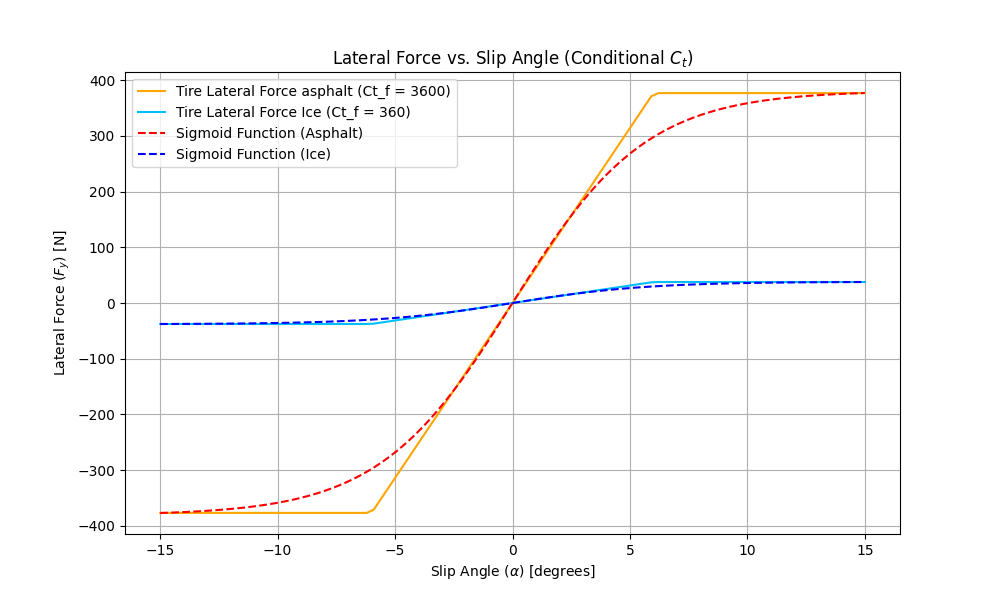

In [24]:
import numpy as np
import matplotlib.pyplot as plt

# Define slip angle range
alpha_degrees = np.linspace(-15, 15, 100)  # Slip angles from -15° to 15°
alpha_radians = np.radians(alpha_degrees)  # Convert to radians

# Original cornering stiffness values
Ct_f = p_vals[9]  # Front tire cornering stiffness (N/rad)
Ct_r = p_vals[8]  # Rear tire cornering stiffness (N/rad)

# New cornering stiffness values
Ct_ice = 360  # New rear tire cornering stiffness (N/rad)

# Compute lateral forces for original values
Fyf_graph = np.where(
    (alpha_degrees >= -6) & (alpha_degrees <= 6),  # Condition
    Ct_f * alpha_radians,  # True: Use linear relationship
    Ct_f * np.radians(6) * np.sign(alpha_degrees)  # False: Use value at 6° or -6°
)


# Compute lateral forces for new values
Fyf_graph_ice = np.where(
    (alpha_degrees >= -6) & (alpha_degrees <= 6),  # Condition
    Ct_ice * alpha_radians,  # True: Use linear relationship
    Ct_ice * np.radians(6) * np.sign(alpha_degrees)  # False: Use value at 6° or -6°
)

# Define the standard equation (sigmoid function)
def sigmoid(x, a, k, x0, c):
    return a / (1 + np.exp(-k * (x - x0))) + c

# Parameters for the sigmoid function (asphalt)
a_asphalt = 0.21176 * Ct_f # Maximum value
k_asphalt = 0.35  # Steepness
x0_asphalt = 0    # Horizontal shift
c_asphalt = -a_asphalt / 2  # Vertical shift

# Parameters for the sigmoid function (ice)
a_ice = 0.21176 * Ct_ice # Maximum value
k_ice = 0.35  # Steepness
x0_ice = 0    # Horizontal shift
c_ice = -a_ice / 2  # Vertical shift

# Compute the sigmoid function values
sigmoid_values_asphalt = sigmoid(alpha_degrees, a_asphalt, k_asphalt, x0_asphalt, c_asphalt)
sigmoid_values_ice = sigmoid(alpha_degrees, a_ice, k_ice, x0_ice, c_ice)

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(alpha_degrees, Fyf_graph, label='Tire Lateral Force asphalt (Ct_f = 3600)', color='orange')
# plt.plot(alpha_degrees, Fyf_graph_snow, label='Tire Lateral Force Snow (Ct_f = 1200)', color='green') # deepskyblue
plt.plot(alpha_degrees, Fyf_graph_ice, label='Tire Lateral Force Ice (Ct_f = 360)', color='deepskyblue')
plt.plot(alpha_degrees, sigmoid_values_asphalt, label='Sigmoid Function (Asphalt)', linestyle='--', color='red')
# plt.plot(alpha_degrees, sigmoid_values_snow, label='Sigmoid Function (Snow)', linestyle='--', color='yellowgreen')
plt.plot(alpha_degrees, sigmoid_values_ice, label='Sigmoid Function (Ice)', linestyle='--', color='blue') # blue
plt.xlabel('Slip Angle ($\\alpha$) [degrees]')
plt.ylabel('Lateral Force ($F_y$) [N]')
plt.title('Lateral Force vs. Slip Angle (Conditional $C_t$)')
plt.grid(True)
plt.legend()
plt.show()
########## values from Crolla, automotive engineering

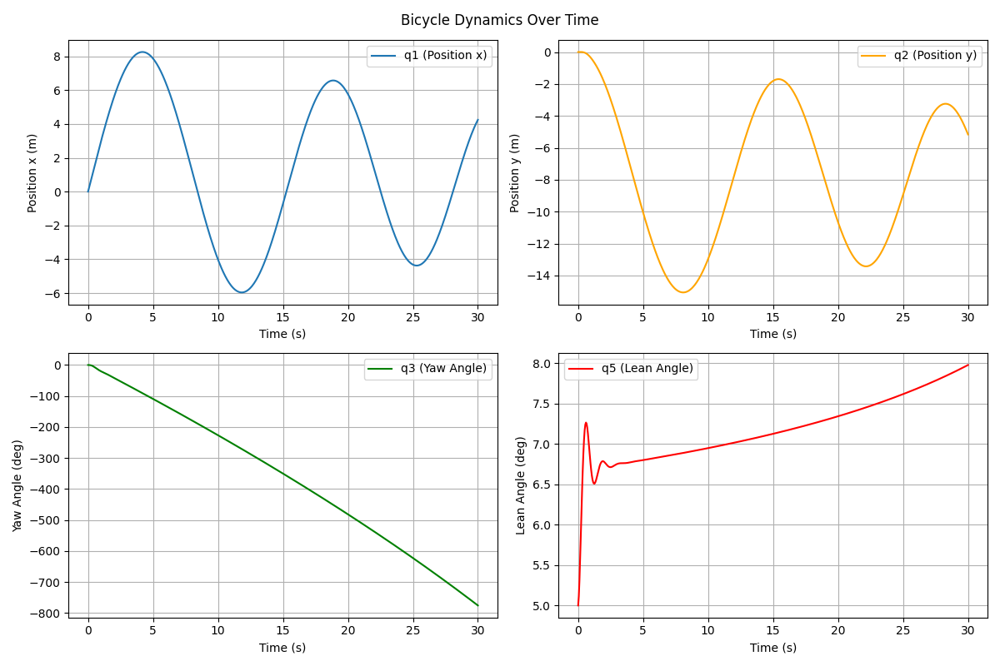

In [15]:
xs = np.transpose(sol.y)

# Extract the time points
ts = sol.t

# Create a figure with 4 subplots (2 rows, 2 columns)
fig, axs = plt.subplots(2, 2, figsize=(12, 8))  # 2 rows, 2 columns
fig.suptitle('Bicycle Dynamics Over Time')  # Overall title for the figure

# Plot q1 (position x) in the first subplot
axs[0, 0].plot(ts, xs[:, 0], label='q1 (Position x)')
axs[0, 0].set_xlabel('Time (s)')
axs[0, 0].set_ylabel('Position x (m)')
axs[0, 0].legend()
axs[0, 0].grid()

# Plot q2 (position y) in the second subplot
axs[0, 1].plot(ts, xs[:, 1], label='q2 (Position y)', color='orange')
axs[0, 1].set_xlabel('Time (s)')
axs[0, 1].set_ylabel('Position y (m)')
axs[0, 1].legend()
axs[0, 1].grid()

# Plot q3 (yaw angle) in the third subplot
axs[1, 0].plot(ts, np.rad2deg(xs[:, 2]), label='q3 (Yaw Angle)', color='green')
axs[1, 0].set_xlabel('Time (s)')
axs[1, 0].set_ylabel('Yaw Angle (deg)')
axs[1, 0].legend()
axs[1, 0].grid()

# Plot q5 (lean angle) in the fourth subplot
axs[1, 1].plot(ts, np.rad2deg(xs[:, 3]), label='q5 (Lean Angle)', color='red')
axs[1, 1].set_xlabel('Time (s)')
axs[1, 1].set_ylabel('Lean Angle (deg)')
axs[1, 1].legend()
axs[1, 1].grid()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

In [16]:
# import matplotlib.pyplot as plt

# # Solve the system
# # Trim slip angle arrays to match the length of sol.t
# alpha_f_vals = alpha_f_vals[:len(sol.t)]
# alpha_b_vals = alpha_b_vals[:len(sol.t)]

# # Plot slip angles over time
# plt.figure(figsize=(10, 6))
# plt.plot(ts, np.rad2deg(alpha_f_vals), label=r'$\alpha_f$ (front slip angle)')
# plt.plot(ts, np.rad2deg(alpha_b_vals), label=r'$\alpha_b$ (rear slip angle)')
# plt.xlabel('Time [s]')
# plt.ylabel('Slip Angle [deg]')
# plt.title('Slip Angles Over Time')
# plt.legend()
# plt.grid()
# plt.show()



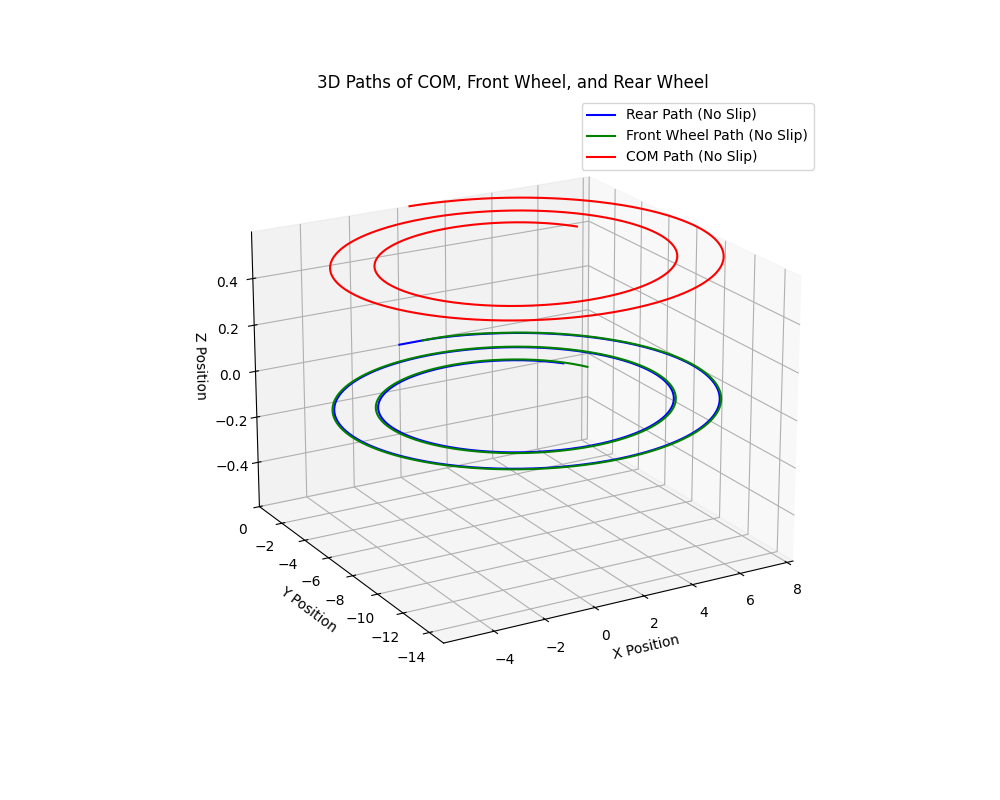

In [17]:

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Import the 3D toolkit

def extract_positions(solution):
    """Extract the positions of the COM, Wf, and Wb from the solution."""
    xB_vals = solution.y[0]  # xB is the x position
    yB_vals = solution.y[1]  # yB is the y position
    yaw_vals = solution.y[2]  # yaw is the yaw angle
    theta_vals = solution.y[3]  # theta is the pitch angle

    # Example values for p_vals (replace with actual values)
    p_vals = [1.0, 0.5, 0.2, 0.1, 0.3, 0.4, 0.6]  # Replace with your actual p_vals

    # Recalculate positions of Wf and Wb from q and u if needed
    Rear_x = xB_vals
    Rear_y = yB_vals

    Front_x = xB_vals + p_vals[0] * np.cos(yaw_vals)
    Front_y = yB_vals + p_vals[0] * np.sin(yaw_vals)

    CB_x = xB_vals + p_vals[0] / 2 * np.cos(yaw_vals)
    CB_y = yB_vals + p_vals[0] / 2 * np.sin(yaw_vals)
    # CB_z = 0

    COM_x = CB_x - p_vals[6] * np.sin(yaw_vals) * np.sin(theta_vals)
    COM_y = CB_y - p_vals[6] * np.sin(theta_vals) * np.sin(yaw_vals)
    COM_z = p_vals[6] * np.cos(theta_vals)

    return Rear_x, Rear_y, Front_x, Front_y, CB_x, CB_y, COM_x, COM_y, COM_z

# Extracting positions for the solution
Rear_x, Rear_y, Front_x, Front_y, CB_x, CB_y, COM_x, COM_y, COM_z = extract_positions(sol)

# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')  # Create a 3D axis

# Plot the paths in 3D
ax.plot(Rear_x, Rear_y, np.zeros_like(Rear_x), 'b-', label="Rear Path (No Slip)")
ax.plot(Front_x, Front_y, np.zeros_like(Front_x), 'g-', label="Front Wheel Path (No Slip)")
ax.plot(COM_x, COM_y, COM_z, 'r-', label="COM Path (No Slip)")

# Add labels and legend
ax.set_xlabel("X Position")
ax.set_ylabel("Y Position")
ax.set_zlabel("Z Position")
ax.set_title("3D Paths of COM, Front Wheel, and Rear Wheel")
ax.legend()
ax.grid(True)

# Set manual scaling for axes
ax.set_xlim([min(Rear_x), max(Rear_x)])
ax.set_ylim([min(Rear_y), max(Rear_y)])
ax.set_zlim([min(-COM_z), max(COM_z)])

# Set the view so that the positive Z-axis is pointing upwards
ax.view_init(elev=20, azim=-120)  # Adjust elev and azim as needed

plt.show()

Text(0, 0.5, '$y$ [m]')

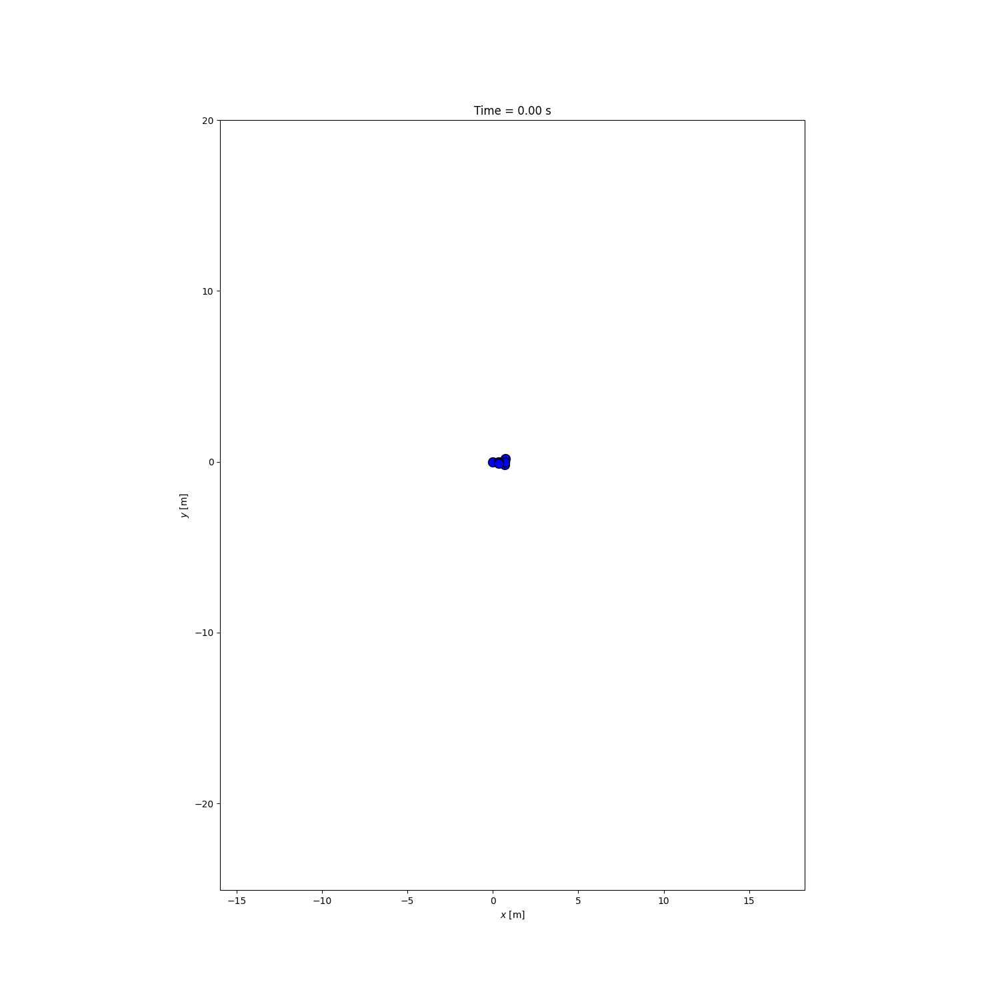

In [18]:
Bl = me.Point('B_l')
Br = me.Point('B_r')
Bl.set_pos(Bo, -l/4*C.y)
Br.set_pos(Bo, l/4*C.y)

steer_val = [np.deg2rad(-8), 0.1]
coordinates = Bo.pos_from(O).to_matrix(N)
for point in [Bl, Bo, Br, Bo, Ao, Co, Ao, COM]:
    coordinates = coordinates.row_join(point.pos_from(O).to_matrix(N))

eval_point_coords = sm.lambdify((q, p, steer), coordinates, cse=True)
eval_point_coords(q0, p_vals, steer_val)

x, y, z = eval_point_coords(q0, p_vals, steer_val)

fig, ax = plt.subplots()
fig.set_size_inches((15.0, 15.0))
ax.set_aspect('equal')

lines, = ax.plot(x, y, color='black',
                 marker='o', markerfacecolor='blue', markersize=10)
# some empty lines to use for the wheel paths
bl_path, = ax.plot([], [])
br_path, = ax.plot([], [])


title_template = 'Time = {:1.2f} s'
title_text = ax.set_title(title_template.format(t0))
ax.set_xlim((np.min(xs[:, 0]) - 10, np.max(xs[:, 0]) + 10))
ax.set_ylim((np.min(xs[:, 1]) - 10, np.max(xs[:, 1]) + 20))
ax.set_xlabel('$x$ [m]')
ax.set_ylabel('$y$ [m]')

In [19]:
coords = []
for xi in xs:
     coords.append(eval_point_coords(xi[:4], p_vals, steer_val))
coords = np.array(coords)  # shape(600, 3, 8)

from IPython.display import HTML
from matplotlib.animation import FuncAnimation
def animate(i):
    title_text.set_text(title_template.format(sol.t[i]))
    lines.set_data(coords[i, 0, :], coords[i, 1, :])
    bl_path.set_data(coords[:i, 0, 0], coords[:i, 1, 0])
    br_path.set_data(coords[:i, 0, 2], coords[:i, 1, 2])

ani = FuncAnimation(fig, animate, len(sol.t))

HTML(ani.to_jshtml(fps=fps))



Animation size has reached 21009694 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Animation size has reached 21017786 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


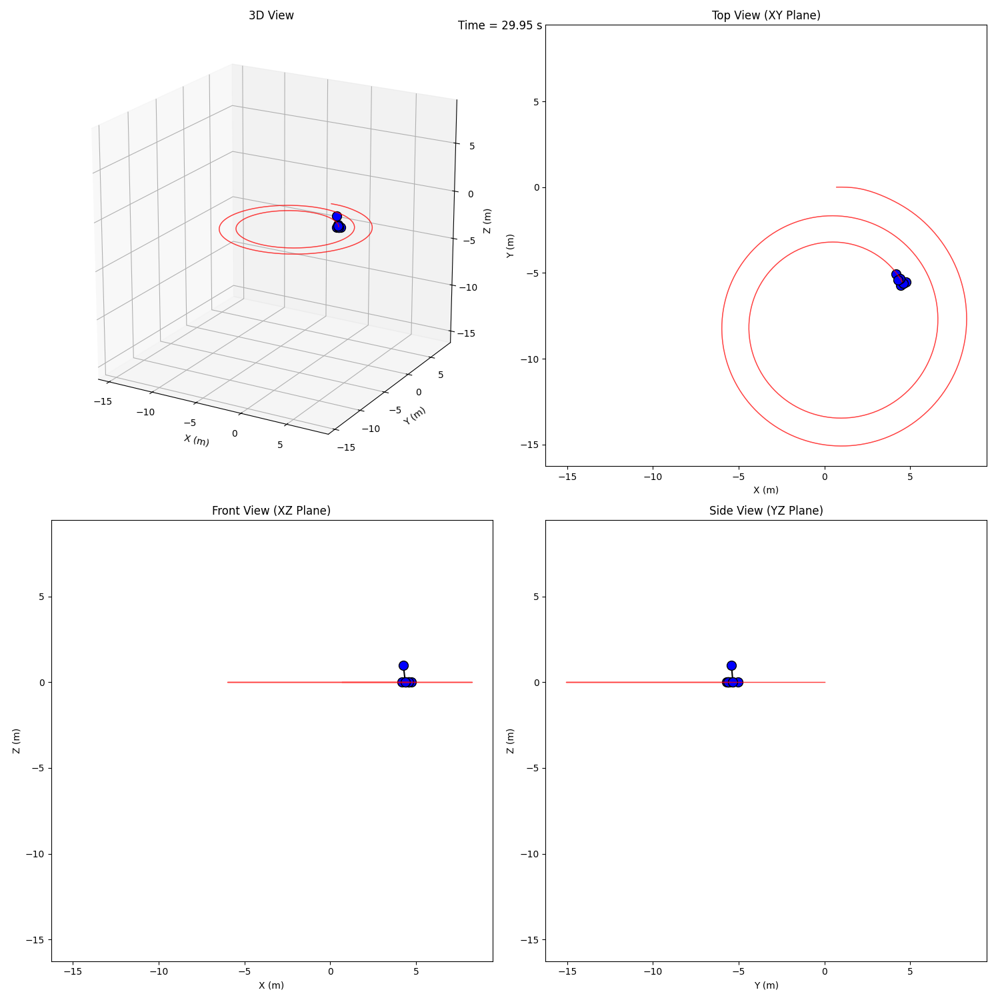

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Prepare coordinates for all time steps
coords = []
for xi in xs:
    coords.append(eval_point_coords(xi[:4], p_vals, steer_val))
coords = np.array(coords)  # shape(600, 3, 8)

# Create the figure
fig = plt.figure(figsize=(15, 15))

# Setup subplots with XY as ground plane, Z up
ax_3d = fig.add_subplot(2, 2, 1, projection='3d')
ax_top = fig.add_subplot(2, 2, 2)       # XY view (looking down from +Z)
ax_front = fig.add_subplot(2, 2, 3)     # XZ view (looking from front, +Y)
ax_side = fig.add_subplot(2, 2, 4)      # YZ view (looking from side, +X)

# Common properties
line_prop = {
    'color': 'black',
    'marker': 'o',
    'markerfacecolor': 'blue',
    'markersize': 10,
}

path_prop = {
    'color': 'red',
    'linewidth': 1,
    'alpha': 0.5
}

# Initialize all views

# 3D View (XY ground, Z up)
lines_3d, = ax_3d.plot([], [], [], **line_prop)
bl_path_3d, = ax_3d.plot([], [], [], **path_prop)
br_path_3d, = ax_3d.plot([], [], [], **path_prop)
ax_3d.set_xlabel('X (m)')
ax_3d.set_ylabel('Y (m)')
ax_3d.set_zlabel('Z (m)')
ax_3d.set_title('3D View')
ax_3d.view_init(elev=20, azim=-60)  # Good viewing angle

# Top View (XY plane - looking down from +Z)
lines_top, = ax_top.plot([], [], **line_prop)
bl_path_top, = ax_top.plot([], [], **path_prop)
br_path_top, = ax_top.plot([], [], **path_prop)
ax_top.set_xlabel('X (m)')
ax_top.set_ylabel('Y (m)')
ax_top.set_title('Top View (XY Plane)')

# Front View (XZ plane - looking from front +Y)
lines_front, = ax_front.plot([], [], **line_prop)
bl_path_front, = ax_front.plot([], [], **path_prop)
br_path_front, = ax_front.plot([], [], **path_prop)
ax_front.set_xlabel('X (m)')
ax_front.set_ylabel('Z (m)')
ax_front.set_title('Front View (XZ Plane)')

# Side View (YZ plane - looking from side +X)
lines_side, = ax_side.plot([], [], **line_prop)
bl_path_side, = ax_side.plot([], [], **path_prop)
br_path_side, = ax_side.plot([], [], **path_prop)
ax_side.set_xlabel('Y (m)')
ax_side.set_ylabel('Z (m)')
ax_side.set_title('Side View (YZ Plane)')

# Calculate equal limits for all dimensions
all_min = min(np.min(coords[:, 0, :]), np.min(coords[:, 1, :]), np.min(coords[:, 2, :])) - 1
all_max = max(np.max(coords[:, 0, :]), np.max(coords[:, 1, :]), np.max(coords[:, 2, :])) + 1

# Set equal limits for all axes in all views
ax_3d.set_xlim(all_min, all_max)
ax_3d.set_ylim(all_min, all_max)
ax_3d.set_zlim(all_min, all_max)
ax_3d.set_box_aspect([1, 1, 1])  # This enforces equal aspect ratio in 3D

# 2D views (use the same limits for consistency)
ax_top.set_xlim(all_min, all_max)
ax_top.set_ylim(all_min, all_max)
ax_top.set_aspect('equal')

ax_front.set_xlim(all_min, all_max)
ax_front.set_ylim(all_min, all_max)
ax_front.set_aspect('equal')

ax_side.set_xlim(all_min, all_max)
ax_side.set_ylim(all_min, all_max)
ax_side.set_aspect('equal')

fig.tight_layout()

title_template = 'Time = {:1.2f} s'
title_text = fig.suptitle(title_template.format(t0))

def animate(i):
    # Update title
    title_text.set_text(title_template.format(sol.t[i]))
    
    # Get current coordinates (X, Y, Z)
    x = coords[i, 0, :]
    y = coords[i, 1, :]
    z = coords[i, 2, :]
    
    # Update 3D view (X,Y,Z)
    lines_3d.set_data_3d(x, y, z)
    bl_path_3d.set_data_3d(coords[:i, 0, 0], coords[:i, 1, 0], coords[:i, 2, 0])
    br_path_3d.set_data_3d(coords[:i, 0, 2], coords[:i, 1, 2], coords[:i, 2, 2])
    
    # Update top view (XY plane)
    lines_top.set_data(x, y)
    bl_path_top.set_data(coords[:i, 0, 0], coords[:i, 1, 0])
    br_path_top.set_data(coords[:i, 0, 2], coords[:i, 1, 2])
    
    # Update front view (XZ plane)
    lines_front.set_data(x, z)
    bl_path_front.set_data(coords[:i, 0, 0], coords[:i, 2, 0])
    br_path_front.set_data(coords[:i, 0, 2], coords[:i, 2, 2])
    
    # Update side view (YZ plane)
    lines_side.set_data(y, z)
    bl_path_side.set_data(coords[:i, 1, 0], coords[:i, 2, 0])
    br_path_side.set_data(coords[:i, 1, 2], coords[:i, 2, 2])

# Create animation
fps = 10
frames = range(0, len(sol.t), 2)  # Use every 2nd frame
ani = FuncAnimation(fig, animate, frames=frames, interval=1000/fps)

# Display in notebook
HTML(ani.to_jshtml(fps=fps))

# Save as GIF
ani.save('bike3D_slip.gif', writer='pillow', fps=fps, dpi=100)

In [21]:
# import numpy as np
# import matplotlib.pyplot as plt
# from matplotlib.animation import FuncAnimation
# from IPython.display import HTML


# # Compute coordinates (replace with your actual function)
# coords = []
# for xi in xs:
#      coords.append(eval_point_coords(xi[:4], p_vals, steer_val))
# coords = np.array(coords)  # shape(600, 3, 8)

# # Create a figure and axis
# fig, ax = plt.subplots()
# ax.set_xlim(np.min(coords[:, 0, :]), np.max(coords[:, 0, :]))
# ax.set_ylim(np.min(coords[:, 1, :]), np.max(coords[:, 1, :]))

# # Initialize plot elements
# lines, = ax.plot([], [], 'b-')  # Line for the current frame
# bl_path, = ax.plot([], [], 'r--')  # Path for the bottom-left point
# br_path, = ax.plot([], [], 'm--')  # Path for the bottom-right point
# title_template = 'Time = {:.2f}s'
# title_text = ax.text(0.5, 1.02, '', transform=ax.transAxes, ha='center')

# # Animation function
# def animate(i):
#     title_text.set_text(title_template.format(sol.t[i]))
#     lines.set_data(coords[i, 0, :], coords[i, 1, :])
#     bl_path.set_data(coords[:i, 0, 0], coords[:i, 1, 0])
#     br_path.set_data(coords[:i, 0, 2], coords[:i, 1, 2])
#     return lines, bl_path, br_path, title_text

# # Create the animation
# fps = 30  # Set the frame rate
# ani = FuncAnimation(fig, animate, frames=len(sol.t), interval=1000/fps, blit=True)

# # Display the animation in the notebook
# HTML(ani.to_jshtml(fps=fps))

# # Save the animation as a GIF
# ani.save('animation_slip.gif', writer='pillow', fps=fps)